In [64]:
import os
import numpy as np
import pandas as pd
import librosa
import soundfile
import matplotlib.pyplot as plt


In [49]:
df = pd.read_csv("D:\Momenta_dataset\ASVspoof5.train.tsv", sep='\t', header=None)

df.head()

,0
0,T_4850 T_0000000000 F - - - AC3 A05 spoof -
1,T_0858 T_0000000001 M - - - AC3 A07 spoof -
2,T_4075 T_0000000002 M - - - AC2 A04 spoof -
3,T_0938 T_0000000003 M - - - AC2 A08 spoof -
4,T_0610 T_0000000004 M - - - AC2 A05 spoof -


In [ ]:
df = df[0].str.split(expand=True)

In [51]:
columns_to_drop = [3,4,5,6,7,9]

df = df.drop(columns=columns_to_drop,axis=1)

df.columns = ['id', 'wav_path', 'gender', 'label']

df.head()

,id,wav_path,gender,label
0,T_4850,T_0000000000,F,spoof
1,T_0858,T_0000000001,M,spoof
2,T_4075,T_0000000002,M,spoof
3,T_0938,T_0000000003,M,spoof
4,T_0610,T_0000000004,M,spoof


In [52]:
df.drop(columns=['id','gender'], axis=1, inplace=True)
df.head()

,wav_path,label
0,T_0000000000,spoof
1,T_0000000001,spoof
2,T_0000000002,spoof
3,T_0000000003,spoof
4,T_0000000004,spoof


In [53]:
df.set_index('wav_path',inplace=True)

df.head()

,label
wav_path,
T_0000000000,spoof
T_0000000001,spoof
T_0000000002,spoof
T_0000000003,spoof
T_0000000004,spoof


In [ ]:

audio_dir = r"D:/Momenta_dataset/flac_T"

new_df = df.copy()

new_df['audio_file_path'] = audio_dir + '/' + new_df.index.astype(str) + ".flac"

new_df.head()

,label,audio_file_path
wav_path,,
T_0000000000,spoof,D:/Momenta_dataset/flac_T/T_0000000000.flac
T_0000000001,spoof,D:/Momenta_dataset/flac_T/T_0000000001.flac
T_0000000002,spoof,D:/Momenta_dataset/flac_T/T_0000000002.flac
T_0000000003,spoof,D:/Momenta_dataset/flac_T/T_0000000003.flac
T_0000000004,spoof,D:/Momenta_dataset/flac_T/T_0000000004.flac


In [55]:
new_df['label'] = new_df['label'].apply(lambda x: 1 if x == 'spoof' else 0)

new_df = new_df[new_df['audio_file_path'].apply(lambda x: os.path.exists(x))]
new_df.shape



(36500, 2)

In [21]:
def lpc(y, m):
    "Return m linear predictive coefficients for sequence y using Levinson-Durbin prediction algorithm"
    #step 1: compute autoregression coefficients R_0, ..., R_m
    R = [y.dot(y)] 
    if R[0] == 0:
        return [1] + [0] * (m-2) + [-1]
    else:
        for i in range(1, m + 1):
            r = y[i:].dot(y[:-i])
            R.append(r)
        R = np.array(R)
    #step 2: 
        A = np.array([1, -R[1] / R[0]])
        E = R[0] + R[1] * A[1]
        for k in range(1, m):
            if (E == 0):
                E = 10e-17
            alpha = - A[:k+1].dot(R[k+1:0:-1]) / E
            A = np.hstack([A,0])
            A = A + alpha * A[::-1]
            E *= (1 - alpha**2)
        return A

In [69]:
def extract_lpc_features(audio_path, order=12):
    audio_path = os.path.normpath(audio_path)
    try:
        y, sr = librosa.load(audio_path, sr=16000)
        if len(y) < order + 1:
            return None
        return lpc(y, order)
    except Exception as e:
        print(f"Error processing {audio_path} (LPC): {e}")
        return None

def extract_mfcc_features(audio_path, n_mfcc=12):
    audio_path = os.path.normpath(audio_path)
    try:
        y, sr = librosa.load(audio_path, sr=16000)
        if len(y) == 0:
            return None
        return np.mean(librosa.feature.mfcc(y=y, sr=sr, n_mfcc=n_mfcc), axis=1)
    except Exception as e:
        print(f"Error processing {audio_path} (MFCC): {e}")
        return None

def extract_zcr(audio_path):
    try:
        y, sr = librosa.load(audio_path, sr=16000)
        return np.mean(librosa.feature.zero_crossing_rate(y))
    except Exception as e:
        print(f"Error processing {audio_path} (ZCR): {e}")
        return None

def extract_spectral_features(audio_path):
    try:
        y, sr = librosa.load(audio_path, sr=16000)
        return [
            np.mean(librosa.feature.spectral_centroid(y=y, sr=sr)),
            np.mean(librosa.feature.spectral_bandwidth(y=y, sr=sr)),
            np.mean(librosa.feature.spectral_contrast(y=y, sr=sr)),
            np.mean(librosa.feature.spectral_rolloff(y=y, sr=sr))
        ]
    except Exception as e:
        print(f"Error processing {audio_path} (Spectral): {e}")
        return None

def extract_hnr(audio_path):
    try:
        y, sr = librosa.load(audio_path, sr=16000)
        return np.mean(librosa.feature.rms(y=y))
    except Exception as e:
        print(f"Error processing {audio_path} (HNR): {e}")
        return None

def extract_formants(audio_path):
    try:
        y, sr = librosa.load(audio_path, sr=16000)
        return [np.mean(librosa.feature.spectral_centroid(y=y, sr=sr))]
    except Exception as e:
        print(f"Error processing {audio_path} (Formants): {e}")
        return None

In [23]:
print(extract_lpc_features(r'D:\Momenta_dataset\flac_T\T_0000000008.flac'))
print(extract_mfcc_features(r'D:\Momenta_dataset\flac_T\T_0000000008.flac'))
print(extract_zcr(r'D:\Momenta_dataset\flac_T\T_0000000008.flac'))
print(extract_spectral_features(r'D:\Momenta_dataset\flac_T\T_0000000008.flac'))
print(extract_hnr(r'D:\Momenta_dataset\flac_T\T_0000000008.flac'))
print(extract_formants(r'D:\Momenta_dataset\flac_T\T_0000000008.flac'))

[ 1.         -1.26765836  0.43006882 -0.24151417  0.28837734 -0.12834299
 -0.0719094  -0.06434506  0.21785333 -0.16493936  0.15688262 -0.16917118
  0.15523139 -0.01586449]
[-356.09082     82.91168     -7.554569    24.432404     4.3292704
  -13.794521   -12.241104   -16.90688     -8.427838    -4.864956
   -7.289102    -9.46221     -2.8928485]
0.14305276710893855
[np.float64(1791.5211025164654), np.float64(1495.0664867839057), np.float64(18.37133391937742), np.float64(3210.3701117318437)]
0.03365438
[np.float64(1791.5211025164654)]


In [ ]:
labels = []
features = []

for index, row in new_df.iterrows():
    audio_path = os.path.normpath(row['audio_file_path'])  # Normalize file path
    label = row['label']
    feature_vector = []
    print(audio_path)
    
    if not os.path.exists(audio_path):
        print(f"File not found: {audio_path}")
        continue
    
    lpc_feat = extract_lpc_features(audio_path)
    mfcc_feat = extract_mfcc_features(audio_path)
    zcr_feat = extract_zcr(audio_path)
    spectral_feat = extract_spectral_features(audio_path)
    hnr_feat = extract_hnr(audio_path)
    formant_feat = extract_formants(audio_path)
    
    if all(feature is not None for feature in [lpc_feat, mfcc_feat, zcr_feat, spectral_feat, hnr_feat, formant_feat]):
        feature_vector.extend(lpc_feat)
        feature_vector.extend(mfcc_feat)
        feature_vector.append(zcr_feat)
        feature_vector.extend(spectral_feat)
        feature_vector.append(hnr_feat)
        feature_vector.extend(formant_feat)
        
        labels.append(label)
        features.append(feature_vector)
    else:
        print(f"Skipping file due to extraction failure: {audio_path}")


D:\Momenta_dataset\flac_T\T_0000000000.flac
D:\Momenta_dataset\flac_T\T_0000000001.flac
D:\Momenta_dataset\flac_T\T_0000000002.flac
D:\Momenta_dataset\flac_T\T_0000000003.flac
D:\Momenta_dataset\flac_T\T_0000000004.flac
D:\Momenta_dataset\flac_T\T_0000000005.flac
D:\Momenta_dataset\flac_T\T_0000000006.flac
D:\Momenta_dataset\flac_T\T_0000000007.flac
D:\Momenta_dataset\flac_T\T_0000000008.flac
D:\Momenta_dataset\flac_T\T_0000000009.flac
D:\Momenta_dataset\flac_T\T_0000000010.flac
D:\Momenta_dataset\flac_T\T_0000000011.flac
D:\Momenta_dataset\flac_T\T_0000000012.flac
D:\Momenta_dataset\flac_T\T_0000000013.flac
D:\Momenta_dataset\flac_T\T_0000000014.flac
D:\Momenta_dataset\flac_T\T_0000000015.flac
D:\Momenta_dataset\flac_T\T_0000000016.flac
D:\Momenta_dataset\flac_T\T_0000000017.flac
D:\Momenta_dataset\flac_T\T_0000000018.flac
D:\Momenta_dataset\flac_T\T_0000000019.flac
D:\Momenta_dataset\flac_T\T_0000000020.flac
D:\Momenta_dataset\flac_T\T_0000000021.flac
D:\Momenta_dataset\flac_T\T_0000

In [27]:
X = np.array(features)
y = np.array(labels)

In [28]:
X.shape, y.shape


((36500, 34), (36500,))

In [29]:
from sklearn.model_selection import train_test_split

In [30]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [31]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

In [32]:
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [ ]:
import xgboost as xgb
from sklearn.metrics import accuracy_score, classification_report

model = xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss')
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test,y_pred)

print(f"XGBoost Model Accuracy: {accuracy:.4f}")
print(classification_report(y_test, y_pred))

c:\Users\DHAIRYA\.conda\envs\llm\Lib\site-packages\xgboost\training.py:183: UserWarning: [22:02:21] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


LPC + MFCC XGBoost Model Accuracy: 0.9588
              precision    recall  f1-score   support

           0       0.89      0.68      0.77       748
           1       0.96      0.99      0.98      6552

    accuracy                           0.96      7300
   macro avg       0.93      0.84      0.87      7300
weighted avg       0.96      0.96      0.96      7300



In [ ]:
from sklearn.svm import SVC

svm_model = SVC(kernel='rbf', C=1, gamma = 'scale')
svm_model.fit(X_train,y_train)

y_pred = svm_model.predict(X_test)

ccuracy = accuracy_score(y_test,y_pred)

print(f"SVM Model Accuracy: {accuracy:.4f}")
print(classification_report(y_test, y_pred))


LPC + MFCC SVM Model Accuracy: 0.9588
              precision    recall  f1-score   support

           0       0.95      0.69      0.80       748
           1       0.97      1.00      0.98      6552

    accuracy                           0.96      7300
   macro avg       0.96      0.84      0.89      7300
weighted avg       0.96      0.96      0.96      7300



<Figure size 1000x600 with 0 Axes>

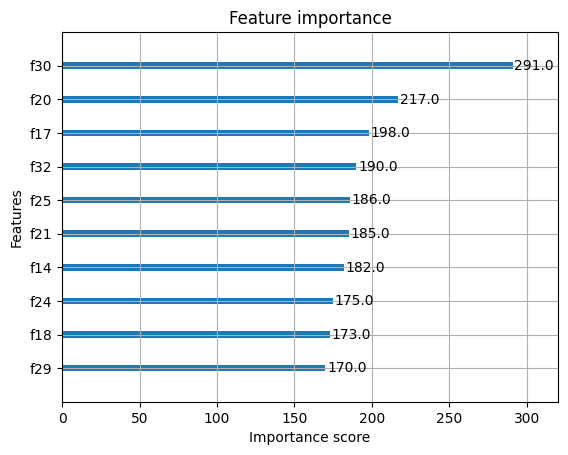

In [35]:
from xgboost import plot_importance

plt.figure(figsize=(10, 6))
plot_importance(model, max_num_features=10)
plt.show()